In [95]:
import os
import cv2
import numpy as np
from sklearn.metrics import cohen_kappa_score
import matplotlib.pyplot as plt
from shapely.geometry import Polygon, Point

# Анализ работы разметчиков

In [96]:
worker_1 = "worker_1_Zh_obb"
worker_2 = "worker_2_Al_obb"
worker_3 = "worker_3_Ig_obb"

annotator1_dir = f"labels_from_workers/{worker_1}/labels/"
annotator2_dir = f"labels_from_workers/{worker_2}/labels/"
annotator3_dir = f"labels_from_workers/{worker_3}/labels/"

images_dir = "images/images_for_labeling_1/"
iou_threshold = 0.6 # Возьмем стандартный порог

### Подсчет коэффициента Каппа

In [97]:
# Необходимые функции
def read_yolo_obb_annotations(annotation_path, img_width, img_height):
    """Чтение YOLO OBB аннотаций и преобразование в абсолютные координаты"""
    
    boxes = []
    if not Path(annotation_path).exists():
        return boxes
        
    with open(annotation_path, "r") as f:
        for line in f.readlines():
            parts = list(map(float, line.strip().split()))
            if len(parts) < 9:  # class_id + 8 координат
                continue
            class_id = int(parts[0])
            points = np.array(parts[1:]).reshape(4, 2)
            points[:, 0] *= img_width
            points[:, 1] *= img_height
            boxes.append((class_id, points))
    return boxes


def calculate_polygon_iou(poly1, poly2):
    """Вычисление Intersection over Union для двух полигонов"""
    
    poly1 = Polygon(poly1)
    poly2 = Polygon(poly2)
    
    if not poly1.is_valid or not poly2.is_valid:
        return 0.0
        
    intersection = poly1.intersection(poly2).area
    union = poly1.union(poly2).area
    
    return intersection / union if union > 0 else 0.0


def visualize_obb_annotations(
    image_path, ann1, ann2, ann3, img_width, img_height, workers_name
):
    """Визуализация OBB разметки трех разметчиков"""
    
    img = cv2.imread(image_path)
    
    if img is None:
        print(f"Ошибка загрузки изображения: {image_path}")
        return
        
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    for box in ann1:
        class_id, points = box
        pts = points.reshape((-1, 1, 2)).astype(int)
        cv2.polylines(img, [pts], isClosed=True, color=(255, 0, 0), thickness=2)
    for box in ann2:
        class_id, points = box
        pts = points.reshape((-1, 1, 2)).astype(int)
        cv2.polylines(img, [pts], isClosed=True, color=(0, 255, 0), thickness=2)
    for box in ann3:
        class_id, points = box
        pts = points.reshape((-1, 1, 2)).astype(int)
        cv2.polylines(img, [pts], isClosed=True, color=(0, 0, 0), thickness=2)
        
    plt.figure(figsize=(12, 8))
    plt.imshow(img)
    plt.title(
        f"Красный - {workers_name[0]} || Зеленый - {workers_name[1]} || Черный - {workers_name[2]}"
    )
    plt.axis("off")
    plt.show()


def compare_obb_annotations(ann1, ann2, ann3, iou_threshold):
    """Сравнение OBB аннотаций трех разметчиков"""
    
    matched_pairs_ann1_ann2 = []
    matched_pairs_ann1_ann3 = []
    matched_pairs_ann2_ann3 = []
    
    unmatched_ann1 = []
    unmatched_ann2 = []
    unmatched_ann3 = []
    
    ann1_with_idx = [(i, box) for i, box in enumerate(ann1)]
    ann2_with_idx = [(i, box) for i, box in enumerate(ann2)]
    ann3_with_idx = [(i, box) for i, box in enumerate(ann3)]
    
    matched_ann1_indices = set()
    matched_ann2_indices = set()
    matched_ann3_indices = set()
    
    for idx1, box1 in ann1_with_idx:
        best_iou_ann2 = 0
        best_match_idx_ann2 = None
        best_match_ann2 = None
        
        for idx2, box2 in ann2_with_idx:
            if idx2 in matched_ann2_indices:
                continue
            if box1[0] == box2[0]:
                iou = calculate_polygon_iou(box1[1], box2[1])
                if iou > best_iou_ann2:
                    best_iou_ann2 = iou
                    best_match_idx_ann2 = idx2
                    best_match_ann2 = box2
        if best_iou_ann2 >= iou_threshold and best_match_ann2 is not None:
            matched_pairs_ann1_ann2.append((box1, best_match_ann2, best_iou_ann2))
            matched_ann1_indices.add(idx1)
            matched_ann2_indices.add(best_match_idx_ann2)
        else:
            unmatched_ann1.append(box1)
            
    for idx1, box1 in ann1_with_idx:
        best_iou_ann3 = 0
        best_match_idx_ann3 = None
        best_match_ann3 = None
        
        for idx3, box3 in ann3_with_idx:
            if idx3 in matched_ann3_indices:
                continue
            if box1[0] == box3[0]:
                iou = calculate_polygon_iou(box1[1], box3[1])
                if iou > best_iou_ann3:
                    best_iou_ann3 = iou
                    best_match_idx_ann3 = idx3
                    best_match_ann3 = box3
        if best_iou_ann3 >= iou_threshold and best_match_ann3 is not None:
            matched_pairs_ann1_ann3.append((box1, best_match_ann3, best_iou_ann3))
            matched_ann1_indices.add(idx1)
            matched_ann3_indices.add(best_match_idx_ann3)
            
    for idx2, box2 in ann2_with_idx:
        if idx2 in matched_ann2_indices:
            continue
        best_iou_ann3 = 0
        best_match_idx_ann3 = None
        best_match_ann3 = None
        for idx3, box3 in ann3_with_idx:
            if idx3 in matched_ann3_indices:
                continue
            if box2[0] == box3[0]:
                iou = calculate_polygon_iou(box2[1], box3[1])
                if iou > best_iou_ann3:
                    best_iou_ann3 = iou
                    best_match_idx_ann3 = idx3
                    best_match_ann3 = box3
        if best_iou_ann3 >= iou_threshold and best_match_ann3 is not None:
            matched_pairs_ann2_ann3.append((box2, best_match_ann3, best_iou_ann3))
            matched_ann2_indices.add(idx2)
            matched_ann3_indices.add(best_match_idx_ann3)
    unmatched_ann2 = [
        box for idx, box in ann2_with_idx if idx not in matched_ann2_indices
    ]
    unmatched_ann3 = [
        box for idx, box in ann3_with_idx if idx not in matched_ann3_indices
    ]
    return (
        matched_pairs_ann1_ann2,
        matched_pairs_ann1_ann3,
        matched_pairs_ann2_ann3,
        unmatched_ann1,
        unmatched_ann2,
        unmatched_ann3,
    )


def calculate_obb_kappa(ann1, ann2, ann3, img_width, img_height, grid_size=10):
    """Расчет коэффициента Каппа для OBB"""
    
    grid_w = img_width // grid_size
    grid_h = img_height // grid_size
    rater1 = np.zeros(grid_w * grid_h, dtype=int)
    rater2 = np.zeros(grid_w * grid_h, dtype=int)
    rater3 = np.zeros(grid_w * grid_h, dtype=int)

    def fill_grid_from_polygon(polygon, grid, grid_w, grid_h, grid_size):
        poly = Polygon(polygon)
        for i in range(grid_w):
            for j in range(grid_h):
                x = (i + 0.5) * grid_size
                y = (j + 0.5) * grid_size
                if poly.contains(Point(x, y)):
                    idx = j * grid_w + i
                    grid[idx] = 1

    for box in ann1:
        fill_grid_from_polygon(box[1], rater1, grid_w, grid_h, grid_size)
    for box in ann2:
        fill_grid_from_polygon(box[1], rater2, grid_w, grid_h, grid_size)
    for box in ann3:
        fill_grid_from_polygon(box[1], rater3, grid_w, grid_h, grid_size)
    if np.array_equal(rater1, rater2):
        return 1.0
    try:
        kappa = cohen_kappa_score(rater1, rater2)
        return kappa if not np.isnan(kappa) else 0.0
    except:
        return 0.0

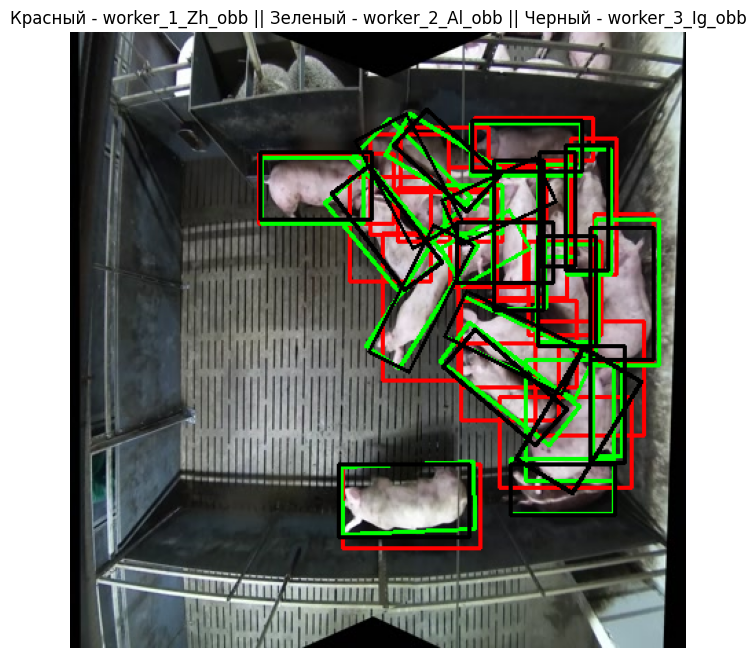


Изображение: 4_frame_0038.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 7
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 9
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 8
Несовпавшие объекты с worker_1_Zh_obb: 11
Несовпавшие объекты с worker_2_Al_obb: 4
Несовпавшие объекты с worker_3_Ig_obb: 2
Коэффициент Каппа: 0.801


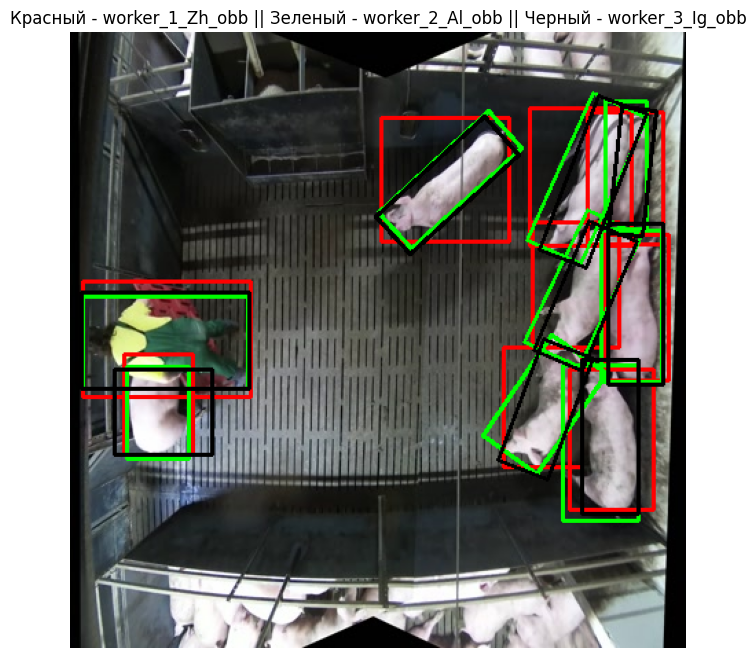


Изображение: 3_frame_0020.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 5
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 5
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 4
Несовпавшие объекты с worker_1_Zh_obb: 4
Несовпавшие объекты с worker_2_Al_obb: 0
Несовпавшие объекты с worker_3_Ig_obb: 0
Коэффициент Каппа: 0.788


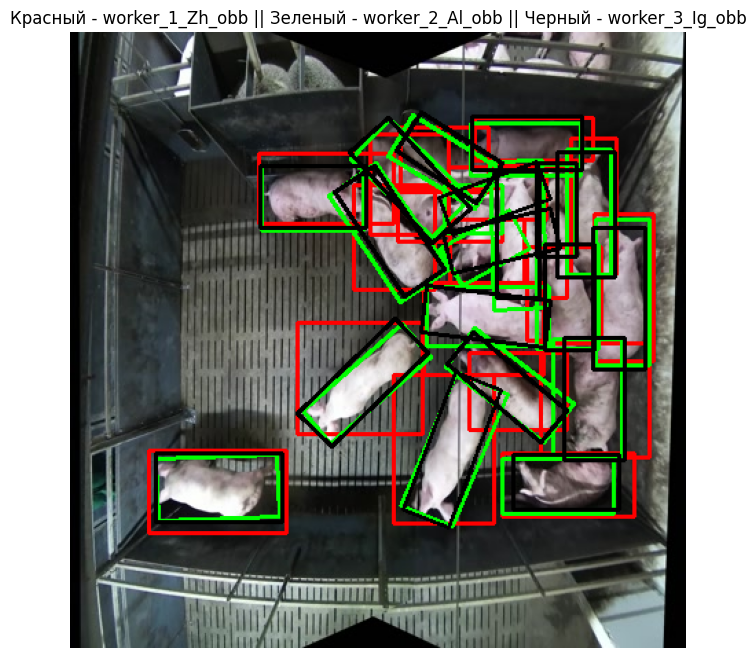


Изображение: 4_frame_0050.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 8
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 9
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 7
Несовпавшие объекты с worker_1_Zh_obb: 11
Несовпавшие объекты с worker_2_Al_obb: 4
Несовпавшие объекты с worker_3_Ig_obb: 3
Коэффициент Каппа: 0.787


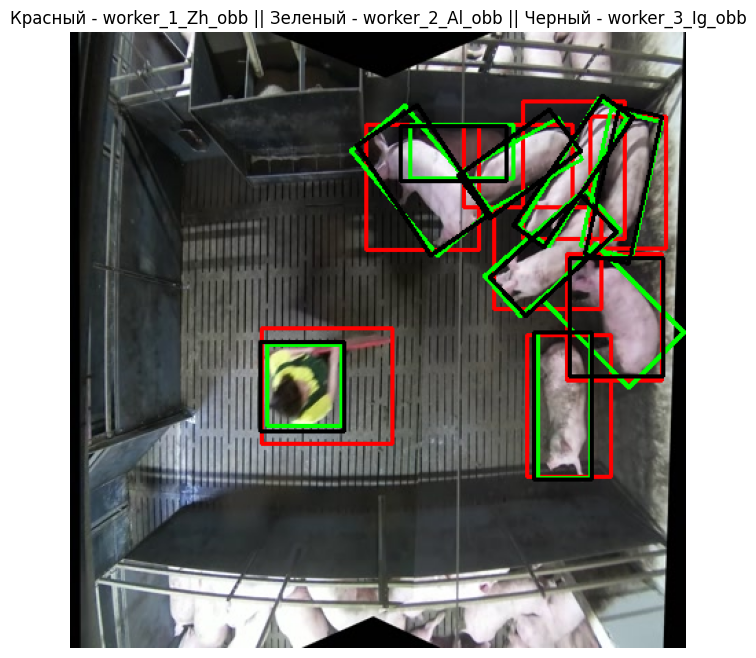


Изображение: 3_frame_0002.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 3
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 2
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 6
Несовпавшие объекты с worker_1_Zh_obb: 5
Несовпавшие объекты с worker_2_Al_obb: 0
Несовпавшие объекты с worker_3_Ig_obb: 1
Коэффициент Каппа: 0.794


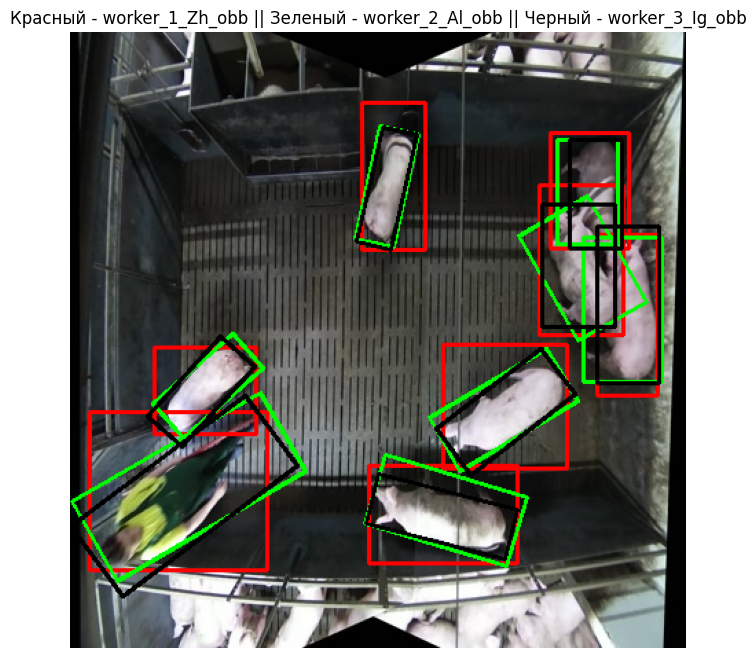


Изображение: 3_frame_0056.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 4
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 3
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 4
Несовпавшие объекты с worker_1_Zh_obb: 4
Несовпавшие объекты с worker_2_Al_obb: 0
Несовпавшие объекты с worker_3_Ig_obb: 1
Коэффициент Каппа: 0.702


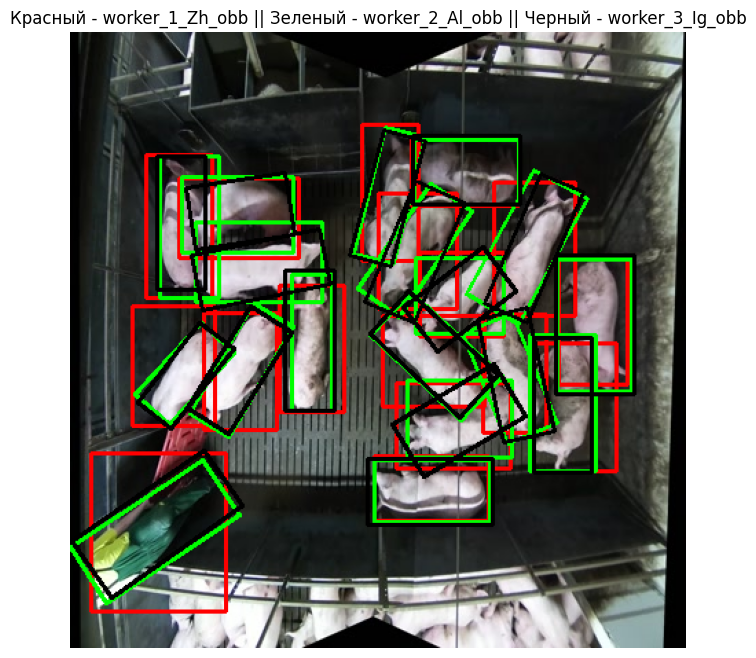


Изображение: 1_frame_0038.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 11
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 13
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 5
Несовпавшие объекты с worker_1_Zh_obb: 8
Несовпавшие объекты с worker_2_Al_obb: 2
Несовпавшие объекты с worker_3_Ig_obb: 0
Коэффициент Каппа: 0.785


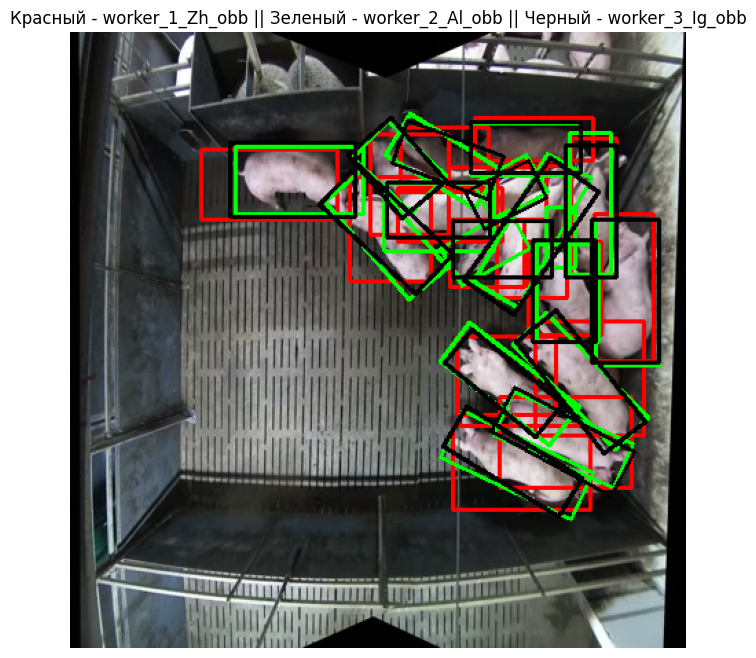


Изображение: 4_frame_0026.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 5
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 8
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 8
Несовпавшие объекты с worker_1_Zh_obb: 11
Несовпавшие объекты с worker_2_Al_obb: 4
Несовпавшие объекты с worker_3_Ig_obb: 0
Коэффициент Каппа: 0.810


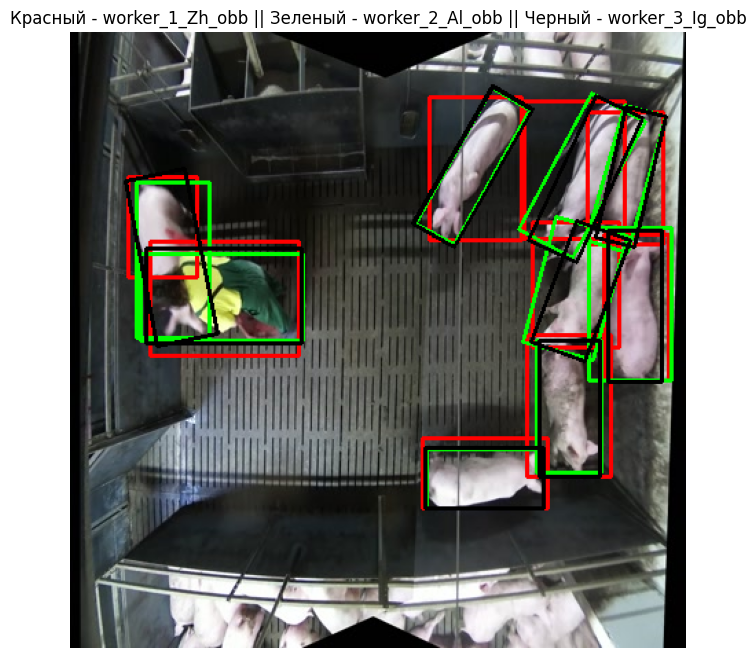


Изображение: 3_frame_0014.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 5
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 5
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 4
Несовпавшие объекты с worker_1_Zh_obb: 4
Несовпавшие объекты с worker_2_Al_obb: 0
Несовпавшие объекты с worker_3_Ig_obb: 0
Коэффициент Каппа: 0.812


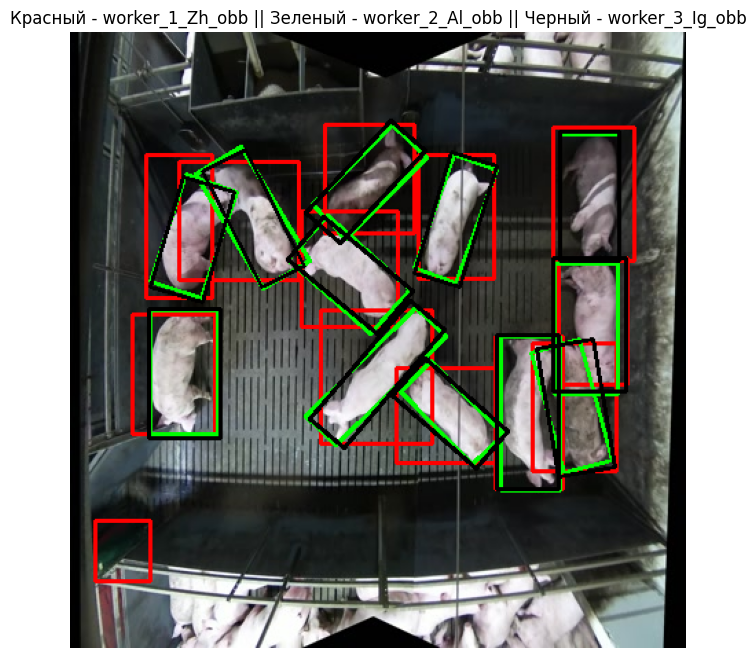


Изображение: 2_frame_0002.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 4
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 6
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 6
Несовпавшие объекты с worker_1_Zh_obb: 10
Несовпавшие объекты с worker_2_Al_obb: 2
Несовпавшие объекты с worker_3_Ig_obb: 0
Коэффициент Каппа: 0.696


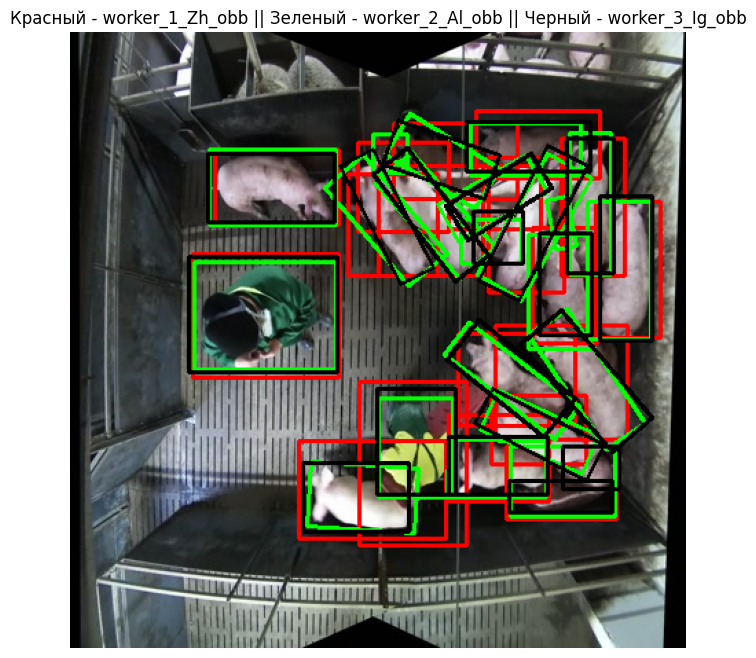


Изображение: 4_frame_0014.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 9
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 7
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 10
Несовпавшие объекты с worker_1_Zh_obb: 10
Несовпавшие объекты с worker_2_Al_obb: 2
Несовпавшие объекты с worker_3_Ig_obb: 3
Коэффициент Каппа: 0.819


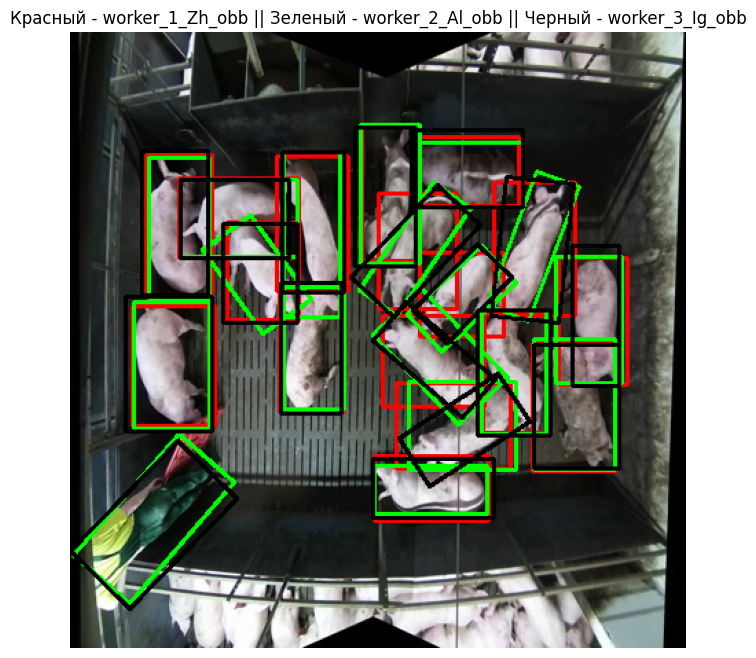


Изображение: 1_frame_0020.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 14
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 13
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 3
Несовпавшие объекты с worker_1_Zh_obb: 4
Несовпавшие объекты с worker_2_Al_obb: 1
Несовпавшие объекты с worker_3_Ig_obb: 2
Коэффициент Каппа: 0.828


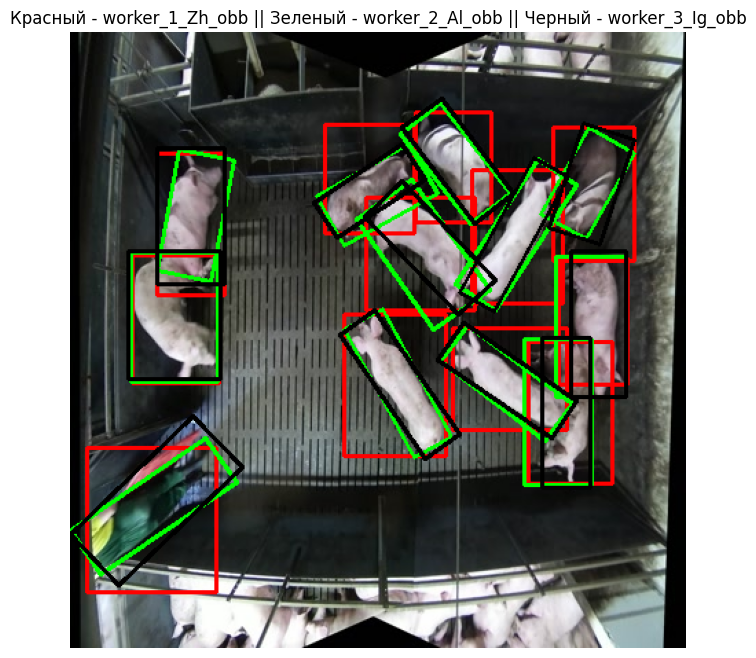


Изображение: 2_frame_0044.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 5
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 3
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 7
Несовпавшие объекты с worker_1_Zh_obb: 7
Несовпавшие объекты с worker_2_Al_obb: 0
Несовпавшие объекты с worker_3_Ig_obb: 2
Коэффициент Каппа: 0.682


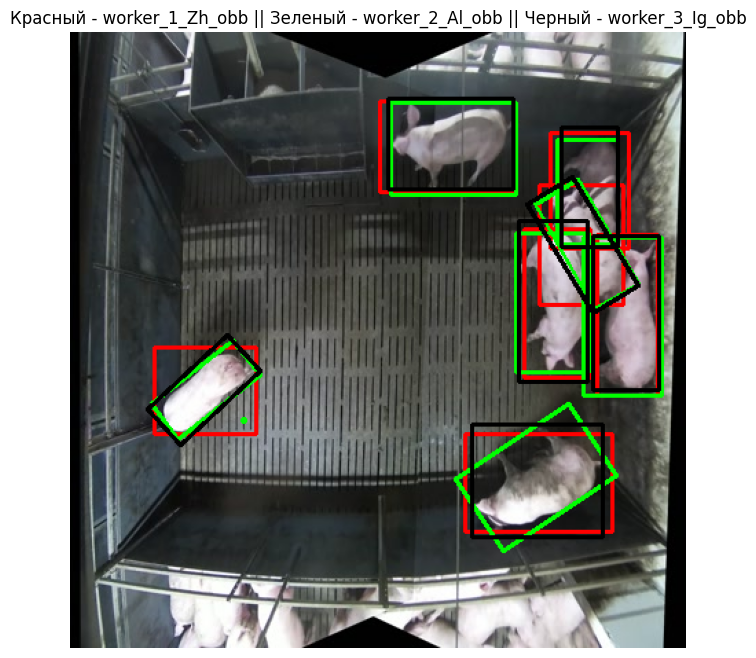


Изображение: 3_frame_0044.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 5
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 5
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 2
Несовпавшие объекты с worker_1_Zh_obb: 2
Несовпавшие объекты с worker_2_Al_obb: 1
Несовпавшие объекты с worker_3_Ig_obb: 0
Коэффициент Каппа: 0.860


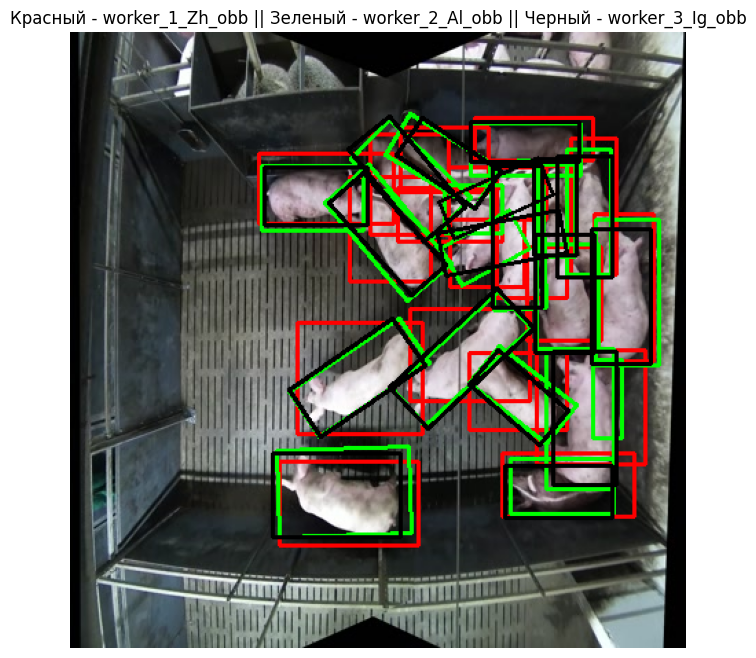


Изображение: 4_frame_0044.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 6
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 5
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 9
Несовпавшие объекты с worker_1_Zh_obb: 12
Несовпавшие объекты с worker_2_Al_obb: 4
Несовпавшие объекты с worker_3_Ig_obb: 4
Коэффициент Каппа: 0.800


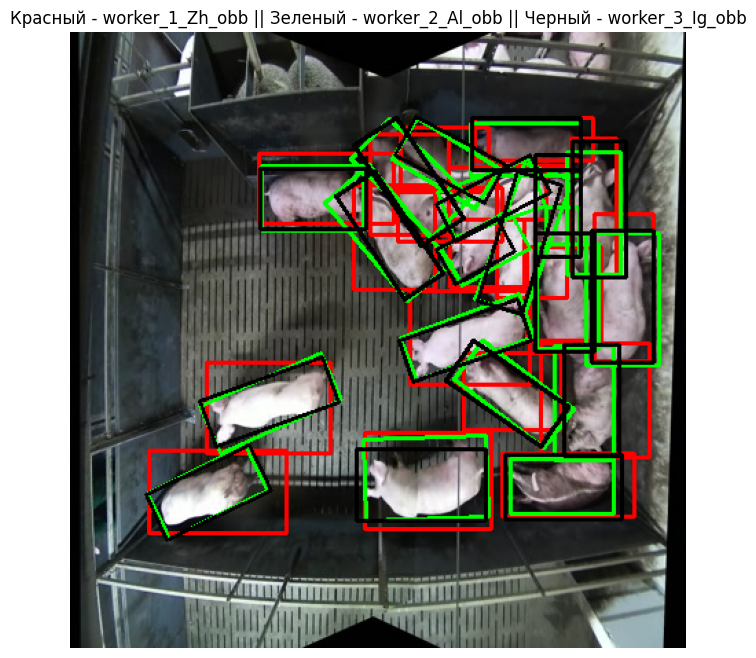


Изображение: 4_frame_0056.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 7
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 7
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 10
Несовпавшие объекты с worker_1_Zh_obb: 12
Несовпавшие объекты с worker_2_Al_obb: 2
Несовпавшие объекты с worker_3_Ig_obb: 2
Коэффициент Каппа: 0.768


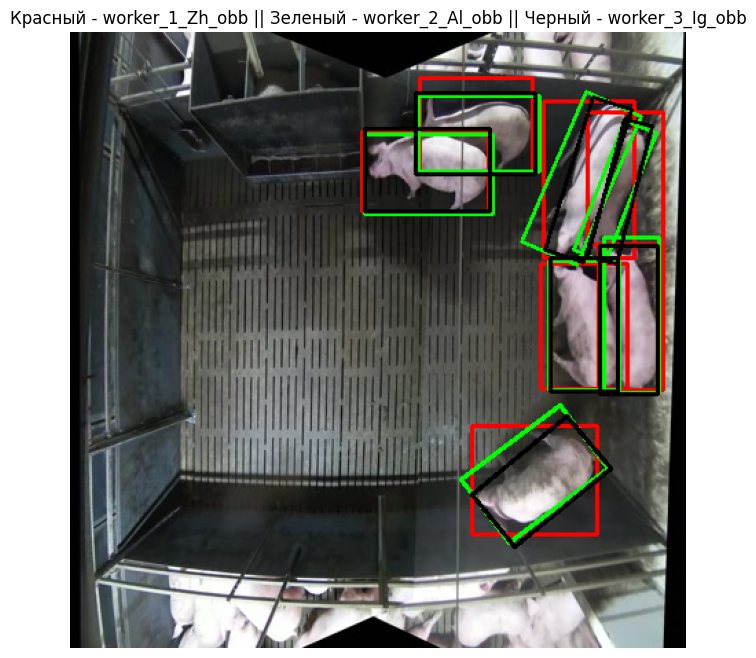


Изображение: 3_frame_0032.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 5
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 4
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 2
Несовпавшие объекты с worker_1_Zh_obb: 2
Несовпавшие объекты с worker_2_Al_obb: 0
Несовпавшие объекты с worker_3_Ig_obb: 1
Коэффициент Каппа: 0.829


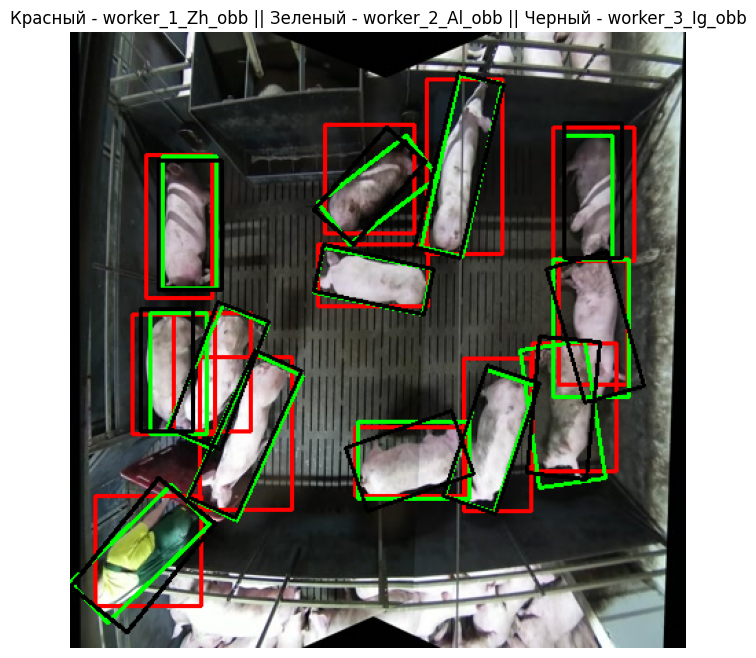


Изображение: 2_frame_0026.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 6
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 10
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 3
Несовпавшие объекты с worker_1_Zh_obb: 8
Несовпавшие объекты с worker_2_Al_obb: 4
Несовпавшие объекты с worker_3_Ig_obb: 0
Коэффициент Каппа: 0.703


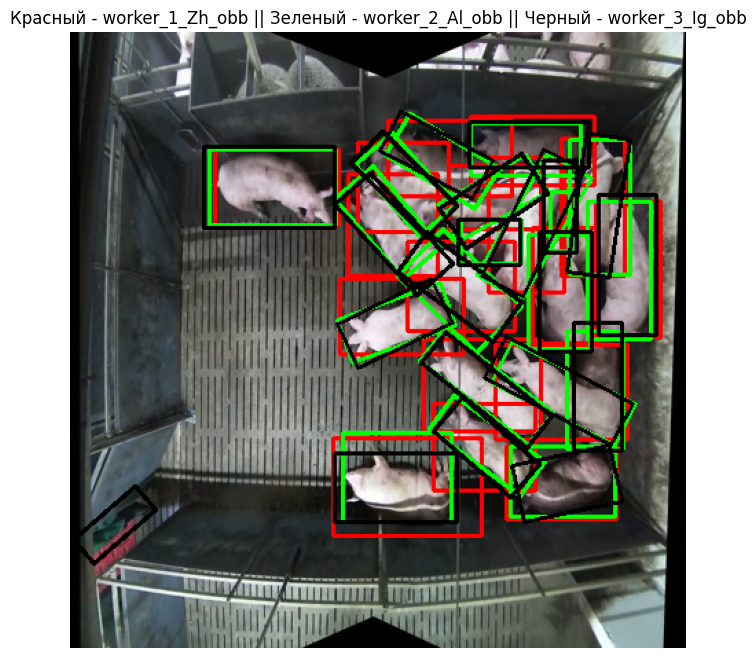


Изображение: 4_frame_0008.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 9
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 7
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 10
Несовпавшие объекты с worker_1_Zh_obb: 8
Несовпавшие объекты с worker_2_Al_obb: 1
Несовпавшие объекты с worker_3_Ig_obb: 4
Коэффициент Каппа: 0.835


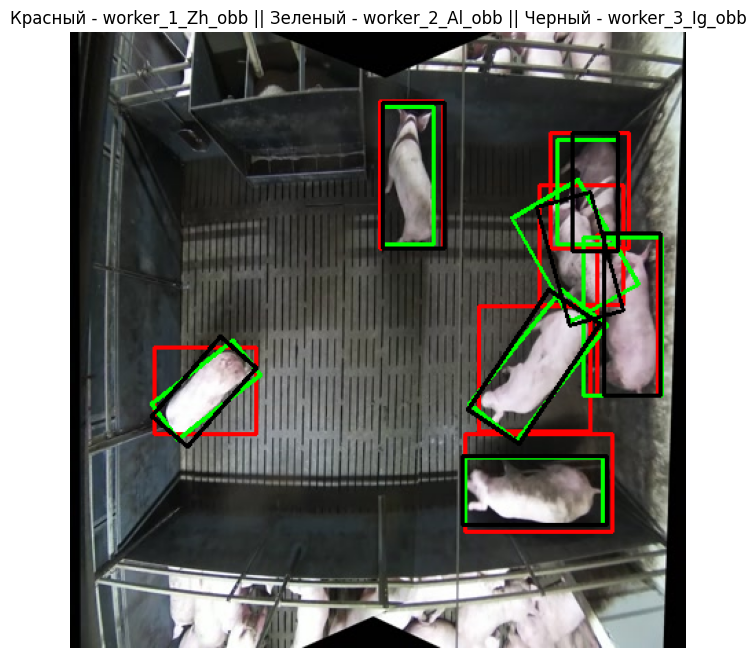


Изображение: 3_frame_0050.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 5
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 3
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 2
Несовпавшие объекты с worker_1_Zh_obb: 2
Несовпавшие объекты с worker_2_Al_obb: 0
Несовпавшие объекты с worker_3_Ig_obb: 2
Коэффициент Каппа: 0.803


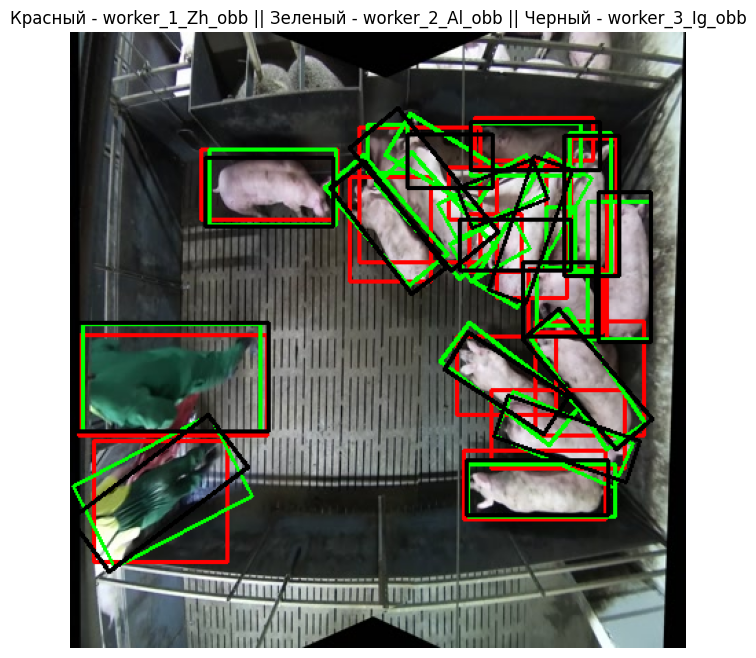


Изображение: 4_frame_0020.jpg
Совпавшие пары объектов (worker_1_Zh_obb - worker_2_Al_obb): 8
Совпавшие пары объектов (worker_1_Zh_obb - worker_3_Ig_obb): 8
Совпавшие пары объектов (worker_2_Al_obb - worker_3_Ig_obb): 5
Несовпавшие объекты с worker_1_Zh_obb: 8
Несовпавшие объекты с worker_2_Al_obb: 6
Несовпавшие объекты с worker_3_Ig_obb: 4
Коэффициент Каппа: 0.835

Средний коэффициент Каппа для 20 изображений: 0.787


In [98]:
# Подсчет согласованности разметчиков

image_files = [
    f.name
    for f in Path(images_dir).iterdir()
    if f.suffix.lower() in (".jpg", ".png", ".jpeg")
]

if not image_files:
    print(f"Ошибка: в папке {images_dir} нет изображений!")
    
total_kappa = 0
processed_images = 0

for img_file in image_files[:20]:
    img_path = Path(images_dir) / img_file
    img = cv2.imread(str(img_path))
    
    if img is None:
        print(f"Ошибка загрузки изображения: {img_path}")
        continue
        
    img_height, img_width = img.shape[:2]
    base_name = Path(img_file).stem
    
    ann1_path = Path(annotator1_dir) / f"{base_name}.txt"
    ann2_path = Path(annotator2_dir) / f"{base_name}.txt"
    ann3_path = Path(annotator3_dir) / f"{base_name}.txt"
    
    ann1 = read_yolo_obb_annotations(ann1_path, img_width, img_height)
    ann2 = read_yolo_obb_annotations(ann2_path, img_width, img_height)
    ann3 = read_yolo_obb_annotations(ann3_path, img_width, img_height)
    
    visualize_obb_annotations(
        img_path,
        ann1,
        ann2,
        ann3,
        img_width,
        img_height,
        [worker_1, worker_2, worker_3],
    )
    (
        matched_ann1_ann2,
        matched_ann1_ann3,
        matched_ann2_ann3,
        unmatched_ann1,
        unmatched_ann2,
        unmatched_ann3,
    ) = compare_obb_annotations(ann1, ann2, ann3, iou_threshold)
    
    print(f"\nИзображение: {img_file}")
    print(f"Совпавшие пары объектов ({worker_1} - {worker_2}): {len(matched_ann1_ann2)}")
    print(f"Совпавшие пары объектов ({worker_1} - {worker_3}): {len(matched_ann1_ann3)}")
    print(f"Совпавшие пары объектов ({worker_2} - {worker_3}): {len(matched_ann2_ann3)}")
    print(f"Несовпавшие объекты с {worker_1}: {len(unmatched_ann1)}")
    print(f"Несовпавшие объекты с {worker_2}: {len(unmatched_ann2)}")
    print(f"Несовпавшие объекты с {worker_3}: {len(unmatched_ann3)}")
    
    kappa = calculate_obb_kappa(ann1, ann2, ann3, img_width, img_height)
    print(f"Коэффициент Каппа: {kappa:.3f}")
    
    total_kappa += kappa
    processed_images += 1
    
if processed_images > 0:
    avg_kappa = total_kappa / processed_images
    print(
        f"\nСредний коэффициент Каппа для {processed_images} изображений: {avg_kappa:.3f}"
    )
else:
    print("Не удалось обработать ни одного изображения")


### Вывод по трем разметчикам

На основе анализа 20 изображений можно сделать следующие выводы о согласованности и качестве работы трех разметчиков:
- `worker_1_Zh_obb`
- `worker_2_Al_obb`
- `worker_3_Ig_obb`

**1. Согласованность между разметчиками**

Согласованность **высокая**, так как средний коэффициент Каппа для всех изображений составляет **0.787**. Значения Каппа для отдельных изображений варьируются от **0.682 до 0.860**, что также подтверждает стабильную работу разметчиков.

Наибольшее количество совпадающих пар чаще всего наблюдается между **worker_2_Al_obb** и **worker_3_Ig_obb** (например, на изображении `4_frame_0056.jpg` — 10 совпадений), что свидетельстует о том, что второй и третий разметчики используют более схожие подходы к разметке.

Разметки **worker_1_Zh_obb** и **worker_2_Al_obb** иногда показывают меньшее количество совпадений (например, на изображении `3_frame_0032.jpg` — только 5 совпадений), что связано с различиями в интерпретации границ объектов. **worker_1_Zh_obb** выделял границы чуть шире и не всегда ориентированно.

**2. Качество разметки**

Несмотря на сложность изображений (на некоторых много свинюшек и пересекающихся bbox) большинство изображений показывают высокий уровень совпадений между разметчиками, следовательно можно сделать вывод о **хорошем качестве разметки**. Коэффициент Каппа выше **0.8** наблюдался на нескольких изображениях, что указывает на отличное согласование.

Исключением стало изображение `2_frame_0044.jpg` — Каппа = `0.682`). Здесь сильно сыграла роль первого разметчика и неверной интерпритации границ объектов.

**3. Итог**
- Для повышения качества разметки следует обсудить проблемные случаи с **worker_1_Zh_obb**.
- Или остановить выбор только на разметчиках **worker_2_Al_obb** и **worker_3_Ig_obb**.

### Сравнение с золотым стандартом

In [107]:
def compare_with_standard(standard_ann, annotator_ann, iou_threshold):
    """Сравнение аннотаций со стандартом"""
    
    results = {
        'true_positives': 0,
        'false_positives': 0,
        'false_negatives': 0,
        'matched_pairs': [],
        'iou_scores': []
    }
    
    matched_annotator_indices = set()
    
    # Ищем совпадения для каждого объекта в стандарте
    for gt_box in standard_ann:
        best_iou = 0
        best_match = None
        best_idx = None
        
        for idx, ann_box in enumerate(annotator_ann):
            if idx in matched_annotator_indices:
                continue
                
            if gt_box[0] == ann_box[0]:  # Проверка совпадения классов
                iou = calculate_polygon_iou(gt_box[1], ann_box[1])
                if iou > best_iou:
                    best_iou = iou
                    best_match = ann_box
                    best_idx = idx
        
        if best_iou >= iou_threshold:
            results['true_positives'] += 1
            matched_annotator_indices.add(best_idx)
            results['matched_pairs'].append((gt_box, best_match, best_iou))
            results['iou_scores'].append(best_iou)  # Сохраняем IoU совпавшей пары
        else:
            results['false_negatives'] += 1
    
    # Оставшиеся аннотации - false positives
    results['false_positives'] = len(annotator_ann) - len(matched_annotator_indices)
    
    return results

def calculate_metrics(results):
    """Расчет метрик качества"""
    
    tp = results['true_positives']
    fp = results['false_positives']
    fn = results['false_negatives']
    
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
    
    # Добавляем среднее IoU
    mean_iou = np.mean(results['iou_scores']) if results['iou_scores'] else 0
    
    return {
        'precision': precision,
        'recall': recall,
        'f1_score': f1,
        'mean_iou': mean_iou  # Среднее IoU
    }

def calculate_cohen_kappa(results, total_objects):
    """Расчет Каппа Коэна"""
    
    tp = results['true_positives']
    fp = results['false_positives']
    fn = results['false_negatives']
    
    # Наблюдаемое согласие
    observed_agreement = tp / total_objects if total_objects > 0 else 0
    
    # Вероятности для ожидаемого согласия
    p_yes = tp / total_objects if total_objects > 0 else 0
    p_no = (fp + fn) / total_objects if total_objects > 0 else 0
    
    # Ожидаемое согласие
    expected_agreement = p_yes**2 + p_no**2
    
    # Каппа Коэна
    kappa = (observed_agreement - expected_agreement) / (1 - expected_agreement) if (1 - expected_agreement) > 0 else 0
    
    return kappa

def calculate_obb_kappa(ann1, ann2, img_width, img_height, grid_size=10):
    """Расчет коэффициента Каппа для OBB"""
    
    grid_w = img_width // grid_size
    grid_h = img_height // grid_size
    rater1 = np.zeros(grid_w * grid_h, dtype=int)
    rater2 = np.zeros(grid_w * grid_h, dtype=int)
    
    def fill_grid_from_polygon(polygon, grid, grid_w, grid_h, grid_size):
        poly = Polygon(polygon)
        for i in range(grid_w):
            for j in range(grid_h):
                x = (i + 0.5) * grid_size
                y = (j + 0.5) * grid_size
                if poly.contains(Point(x, y)):
                    idx = j * grid_w + i
                    grid[idx] = 1
    
    for box in ann1:
        fill_grid_from_polygon(box[1], rater1, grid_w, grid_h, grid_size)
    for box in ann2:
        fill_grid_from_polygon(box[1], rater2, grid_w, grid_h, grid_size)
    
    if np.array_equal(rater1, rater2):
        return 1.0
    
    try:
        kappa = cohen_kappa_score(rater1, rater2)
        return kappa if not np.isnan(kappa) else 0.0
    except:
        return 0.0

def visualize_comparison(image_path, standard_ann, annotator_ann, img_width, img_height):
    """Визуализация сравнения со стандартом"""
    
    img = cv2.imread(str(image_path))
    if img is None:
        print(f"Ошибка загрузки изображения: {image_path}")
        return
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Рисуем стандарт (фиолетовый)
    for box in standard_ann:
        class_id, points = box
        pts = points.reshape((-1, 1, 2)).astype(int)
        cv2.polylines(img, [pts], isClosed=True, color=(255, 0, 255), thickness=2)
    
    # Рисуем аннотатора (красный)
    for box in annotator_ann:
        class_id, points = box
        pts = points.reshape((-1, 1, 2)).astype(int)
        cv2.polylines(img, [pts], isClosed=True, color=(255, 0, 0), thickness=2)
    
    plt.figure(figsize=(12, 8))
    plt.imshow(img)
    plt.title("Фиолетовый - Стандарт || Красный - Разметчик")
    plt.axis('off')
    plt.show()

def process_directory(standard_dir, annotator_dir, images_dir, iou_threshold):
    """Обработка всех изображений в директории"""
    
    standard_path = Path(standard_dir)
    annotator_path = Path(annotator_dir)
    images_path = Path(images_dir)
    
    total_metrics = {
        'true_positives': 0,
        'false_positives': 0,
        'false_negatives': 0,
        'iou_scores': [],
        'kappa_scores': []
    }
    
    processed_files = 0
    
    for img_file in images_path.glob('*'):
        if img_file.suffix.lower() not in ['.jpg', '.png', '.jpeg']:
            continue
            
        img = cv2.imread(str(img_file))
        if img is None:
            continue
            
        img_height, img_width = img.shape[:2]
        
        # Загружаем аннотации
        ann_file = img_file.with_suffix('.txt')
        standard_ann = read_yolo_obb_annotations(standard_path / ann_file.name, img_width, img_height)
        annotator_ann = read_yolo_obb_annotations(annotator_path / ann_file.name, img_width, img_height)
        
        # Сравниваем
        results = compare_with_standard(standard_ann, annotator_ann, iou_threshold)
        
        # Визуализируем
        visualize_comparison(img_file, standard_ann, annotator_ann, img_width, img_height)
        
        # Выводим результаты
        print(f"\nImage: {img_file.name}")
        print(f"True Positives: {results['true_positives']}")
        print(f"False Positives: {results['false_positives']}")
        print(f"False Negatives: {results['false_negatives']}")
        
        # Считаем метрики
        metrics = calculate_metrics(results)
        print(f"Precision: {metrics['precision']:.3f}")
        print(f"Recall: {metrics['recall']:.3f}")
        print(f"F1 Score: {metrics['f1_score']:.3f}")
        print(f"Mean IoU: {metrics['mean_iou']:.3f}")
        
        # Расчет Каппа Коэна через сетку
        total_objects = results['true_positives'] + results['false_positives'] + results['false_negatives']
        kappa = calculate_obb_kappa(standard_ann, annotator_ann, img_width, img_height)
        total_metrics['kappa_scores'].append(kappa)  
        print(f"Cohen's Kappa (Grid-based): {kappa:.3f}")
        
        # Агрегируем результаты
        total_metrics['true_positives'] += results['true_positives']
        total_metrics['false_positives'] += results['false_positives']
        total_metrics['false_negatives'] += results['false_negatives']
        total_metrics['iou_scores'].extend(results['iou_scores'])
        processed_files += 1
    
    # Выводим итоговые метрики
    if processed_files > 0:
        print("\n=== ИТОГОВЫЕ МЕТРИКИ ===")
        
        final_metrics = calculate_metrics(total_metrics)
        
        print(f"Общее True Positives: {total_metrics['true_positives']}")
        print(f"Общее False Positives: {total_metrics['false_positives']}")
        print(f"Общее False Negatives: {total_metrics['false_negatives']}")
        print(f"Итоговая Precision: {final_metrics['precision']:.3f}")
        print(f"Итоговая Recall: {final_metrics['recall']:.3f}")
        print(f"Итоговый F1 Score: {final_metrics['f1_score']:.3f}")
        print(f"Итоговое Mean IoU: {final_metrics['mean_iou']:.3f}")
        
        # Итоговый Каппа Коэна
        mean_kappa = np.mean(total_metrics['kappa_scores']) if total_metrics['kappa_scores'] else 0
        print(f"Итоговый Cohen's Kappa (Grid-based): {mean_kappa:.3f}")
    else:
        print("Не найдено изображений для обработки")


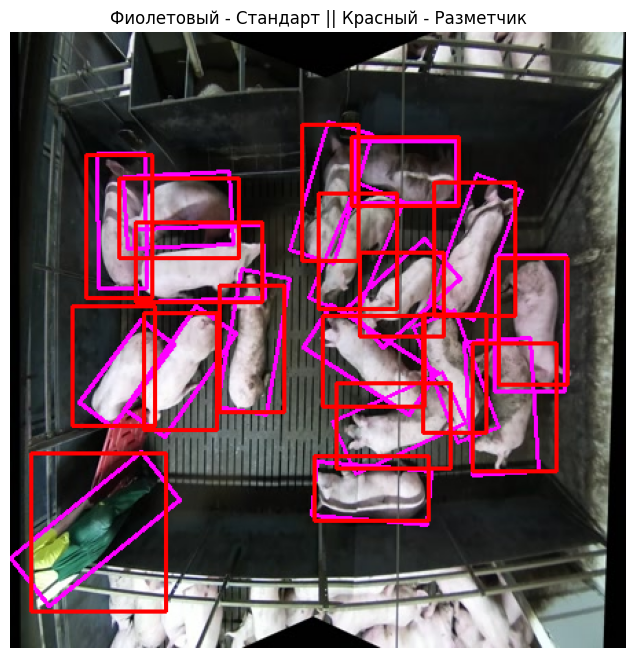


Image: 1_frame_0038.jpg
True Positives: 13
False Positives: 6
False Negatives: 5
Precision: 0.684
Recall: 0.722
F1 Score: 0.703
Mean IoU: 0.718
Cohen's Kappa (Grid-based): 0.765


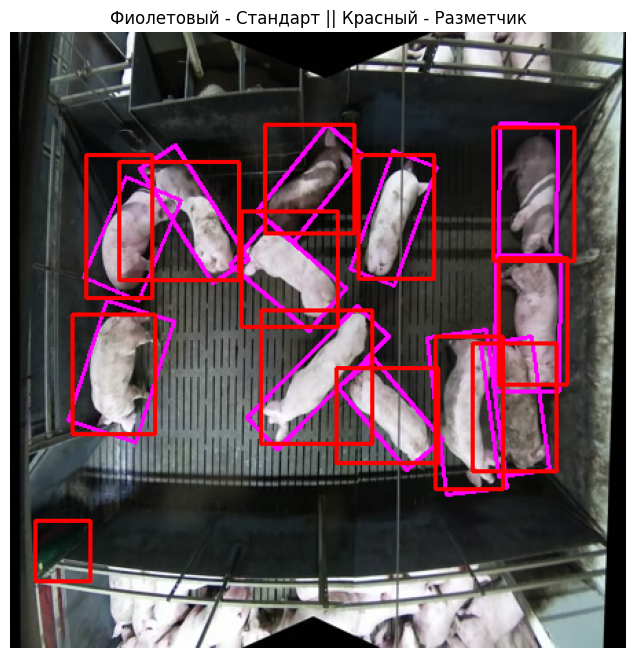


Image: 2_frame_0002.jpg
True Positives: 5
False Positives: 9
False Negatives: 7
Precision: 0.357
Recall: 0.417
F1 Score: 0.385
Mean IoU: 0.720
Cohen's Kappa (Grid-based): 0.696


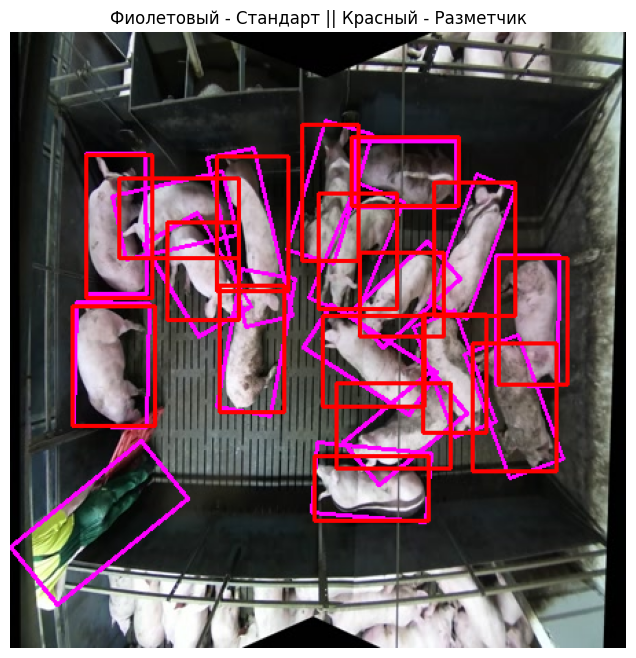


Image: 1_frame_0020.jpg
True Positives: 12
False Positives: 6
False Negatives: 6
Precision: 0.667
Recall: 0.667
F1 Score: 0.667
Mean IoU: 0.742
Cohen's Kappa (Grid-based): 0.763


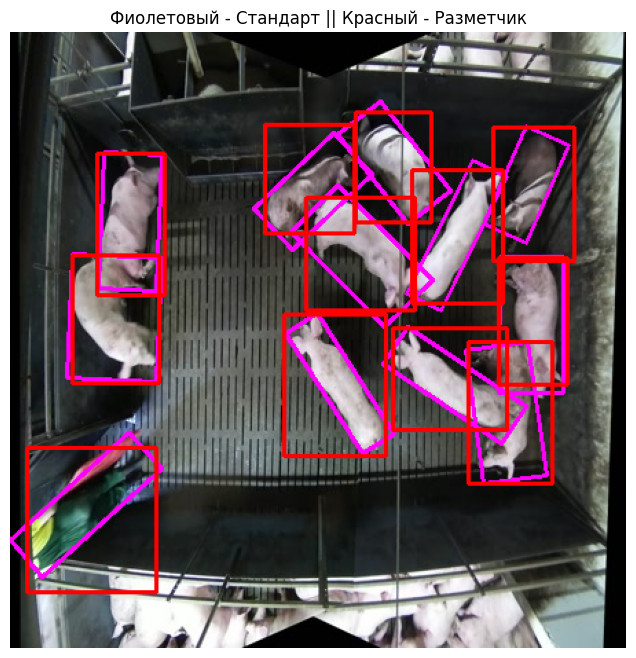


Image: 2_frame_0044.jpg
True Positives: 4
False Positives: 8
False Negatives: 8
Precision: 0.333
Recall: 0.333
F1 Score: 0.333
Mean IoU: 0.836
Cohen's Kappa (Grid-based): 0.659


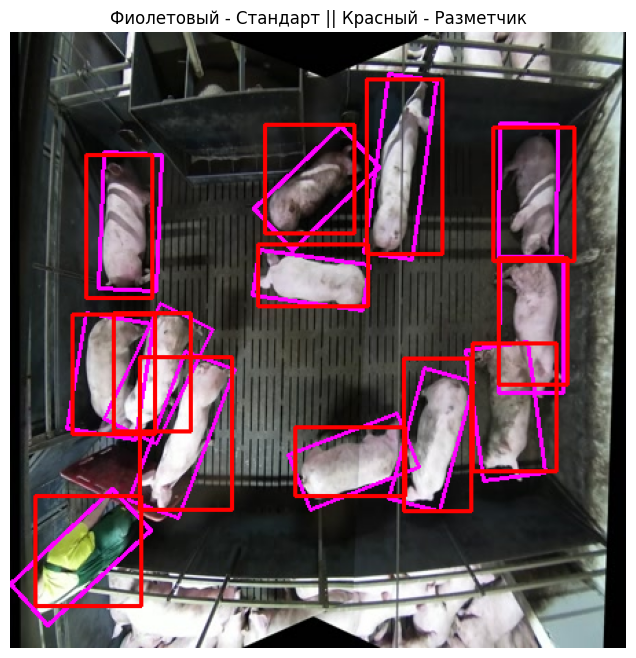


Image: 2_frame_0026.jpg
True Positives: 10
False Positives: 4
False Negatives: 3
Precision: 0.714
Recall: 0.769
F1 Score: 0.741
Mean IoU: 0.697
Cohen's Kappa (Grid-based): 0.748

=== ИТОГОВЫЕ МЕТРИКИ ===
Общее True Positives: 44
Общее False Positives: 33
Общее False Negatives: 29
Итоговая Precision: 0.571
Итоговая Recall: 0.603
Итоговый F1 Score: 0.587
Итоговое Mean IoU: 0.731
Итоговый Cohen's Kappa (Grid-based): 0.726


In [109]:
# Для разметчика worker_1
standard_dir = "golden_set/labels/" 
golden_set_images_dir = "golden_set/images"  

process_directory(standard_dir, annotator1_dir, golden_set_images_dir, iou_threshold)

### Первый разметчик worker_1_Zh_obb

Можно говорить об **умеренном качестве разметки**:
 - **Precision**: примерно `57%` объектов соответствуют стандарту.
 - **Recall**: разметчик находит около `60%` объектов из стандарта.
 - **F1 Score**: `0.587` — гармоническое среднее между точностью и полнотой находится на удовлетворительном уровне.

Средний коэффициент Каппа составляет `0.726`, что указывает на **хорошую согласованность** с эталонной разметкой.
Среднее значение IoU составляет `0.731`, что указывает на **достаточно высокую точность локализации объектов**.

**Проблемные моменты**:
   - Высокое количество **ложноположительных срабатываний (False Positives)**: 33 объекта были отмечены разметчиком, но не соответствуют стандарту -->  **переоценка количества объектов**.
   - Значительное число **ложноотрицательных срабатываний (False Negatives)**: 29 объектов из стандарта не были найдены --> **неточное выделение границ**.

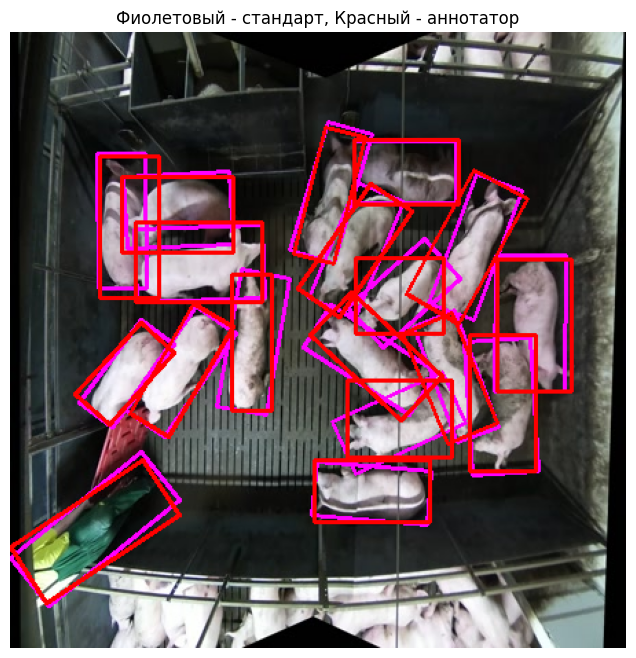


Изображение: 1_frame_0038.jpg
True Positives: 18
False Positives: 0
False Negatives: 0
Precision: 1.000
Recall: 1.000
F1 Score: 1.000
Mean IoU: 0.792
Cohen's Kappa (Grid-based): 0.865


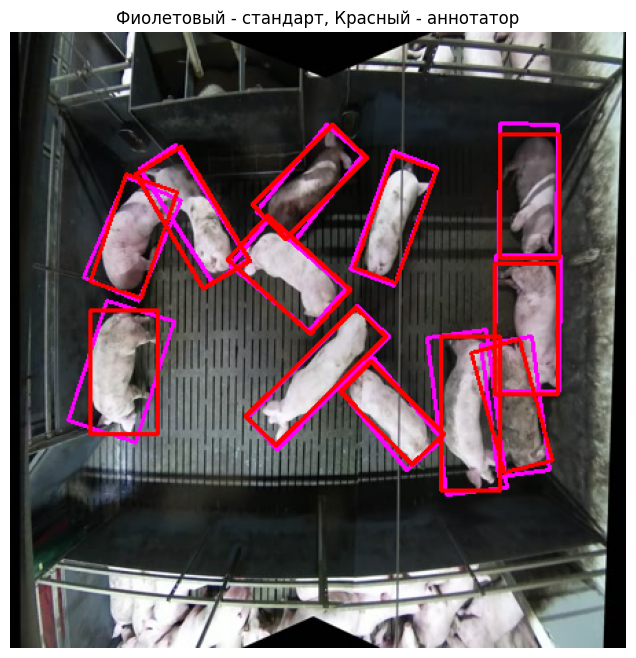


Изображение: 2_frame_0002.jpg
True Positives: 12
False Positives: 0
False Negatives: 0
Precision: 1.000
Recall: 1.000
F1 Score: 1.000
Mean IoU: 0.842
Cohen's Kappa (Grid-based): 0.937


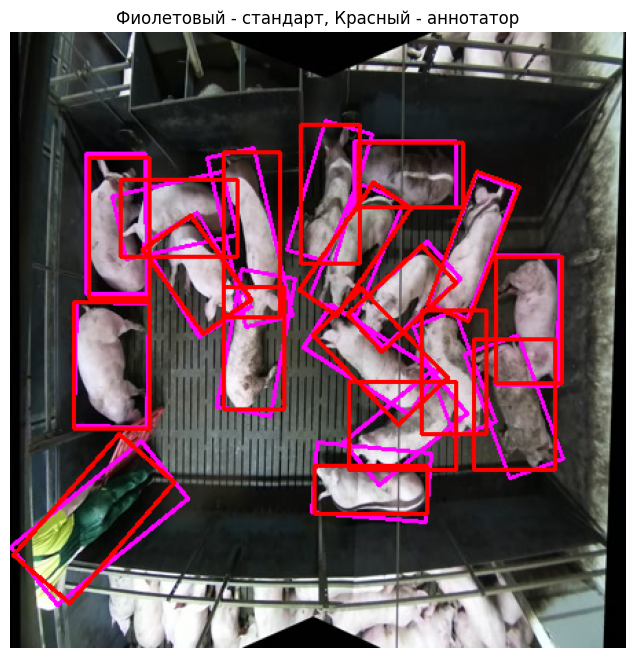


Изображение: 1_frame_0020.jpg
True Positives: 16
False Positives: 2
False Negatives: 2
Precision: 0.889
Recall: 0.889
F1 Score: 0.889
Mean IoU: 0.782
Cohen's Kappa (Grid-based): 0.872


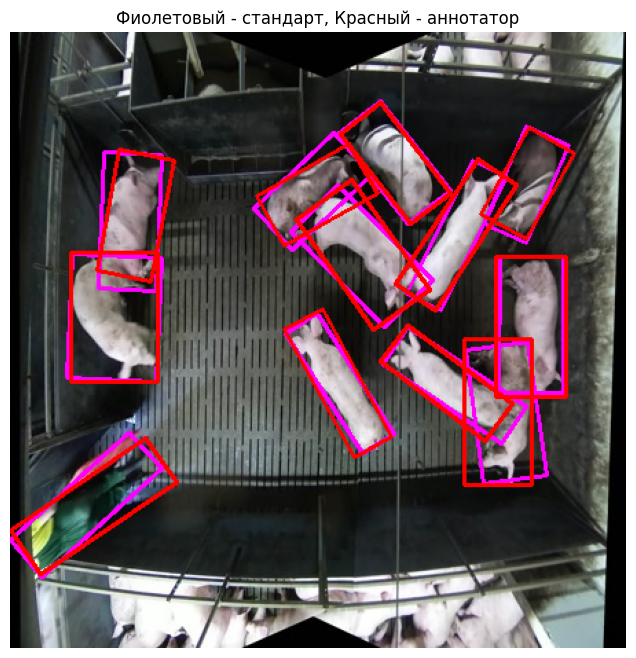


Изображение: 2_frame_0044.jpg
True Positives: 12
False Positives: 0
False Negatives: 0
Precision: 1.000
Recall: 1.000
F1 Score: 1.000
Mean IoU: 0.805
Cohen's Kappa (Grid-based): 0.882


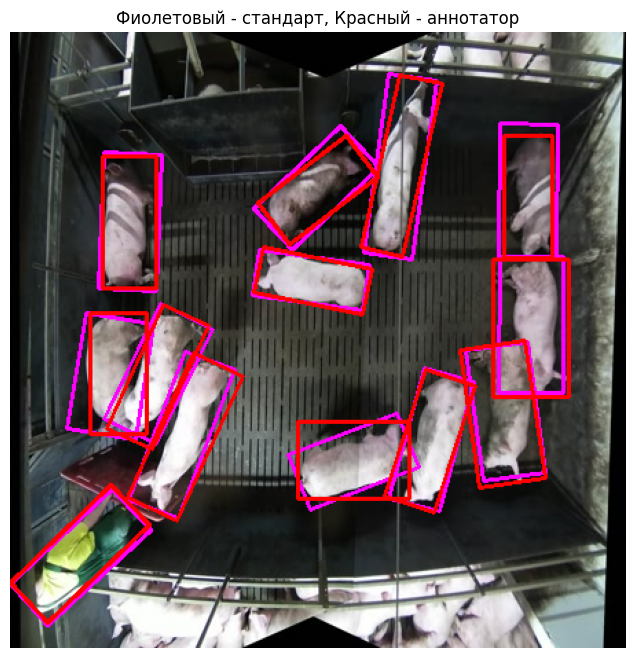


Изображение: 2_frame_0026.jpg
True Positives: 13
False Positives: 0
False Negatives: 0
Precision: 1.000
Recall: 1.000
F1 Score: 1.000
Mean IoU: 0.821
Cohen's Kappa (Grid-based): 0.861

=== ИТОГОВЫЕ МЕТРИКИ ===
Общее True Positives: 71
Общее False Positives: 2
Общее False Negatives: 2
Итоговая Precision: 0.973
Итоговая Recall: 0.973
Итоговый F1 Score: 0.973
Итоговое Mean IoU: 0.806
Итоговый Cohen's Kappa (Grid-based): 0.883


In [101]:
# Для разметчика worker_2
standard_dir = "golden_set/labels/"
golden_set_images_dir = "golden_set/images" 

process_directory(standard_dir, annotator2_dir, golden_set_images_dir, iou_threshold)

### Второй разметчик worker_2_Al_obb

Можно говорить об **очень высоком качестве разметки**:
 - **Precision**: `0.973` — практически все объекты, отмеченные разметчиком, соответствуют стандарту.
 - **Recall**: `0.973` — разметчик находит почти все объекты из стандарта.
 - **F1 Score**: `0.973` — гармоническое среднее между точностью и полнотой также находится на высоком уровне.

Средний коэффициент Каппа составляет `0.883`, что указывает на **очень высокую согласованность** с эталонной разметкой.
На нескольких изображениях (например, `2_frame_0002.jpg` и `2_frame_0044.jpg`) Каппа достигает значений выше `0.88`, что говорит о практически полном совпадении разметки со стандартом.
Среднее значение IoU составляет `0.806`, что указывает на **высокую точность локализации объектов**.

Данный разметчик самый опытный и работает в сфере Computer Vision. А также задавал больше всех вопросов.

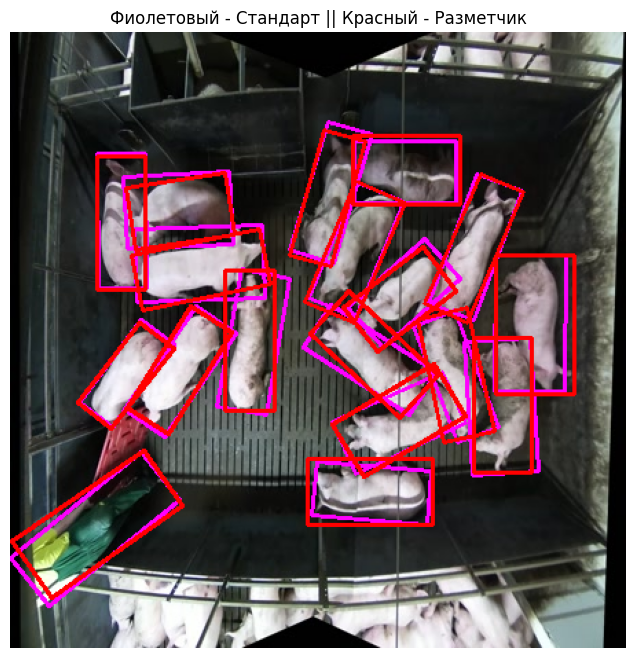


Image: 1_frame_0038.jpg
True Positives: 18
False Positives: 0
False Negatives: 0
Precision: 1.000
Recall: 1.000
F1 Score: 1.000
Mean IoU: 0.831
Cohen's Kappa (Grid-based): 0.897


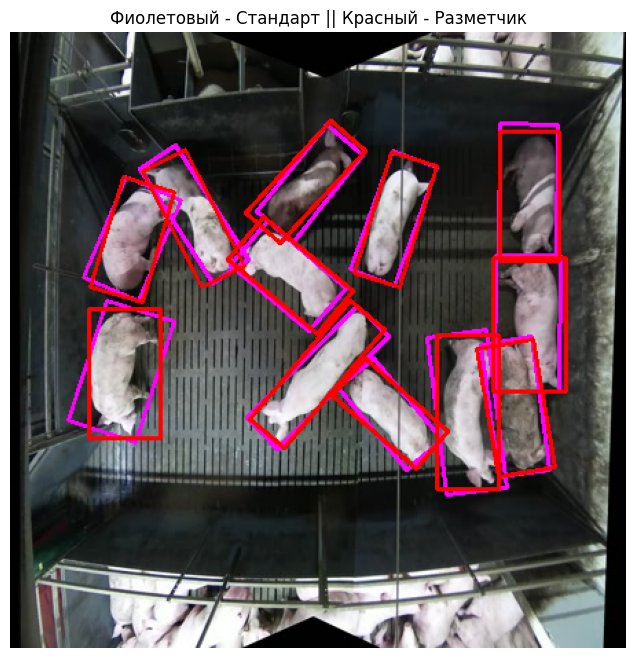


Image: 2_frame_0002.jpg
True Positives: 12
False Positives: 0
False Negatives: 0
Precision: 1.000
Recall: 1.000
F1 Score: 1.000
Mean IoU: 0.826
Cohen's Kappa (Grid-based): 0.915


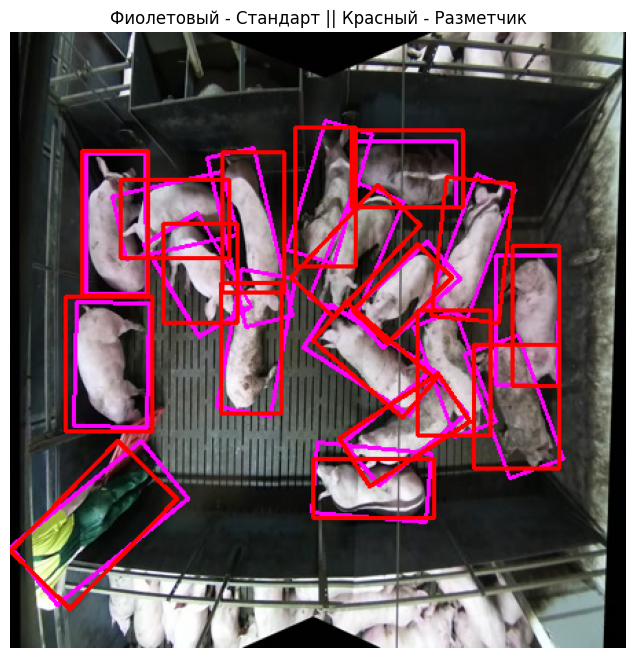


Image: 1_frame_0020.jpg
True Positives: 15
False Positives: 3
False Negatives: 3
Precision: 0.833
Recall: 0.833
F1 Score: 0.833
Mean IoU: 0.747
Cohen's Kappa (Grid-based): 0.826


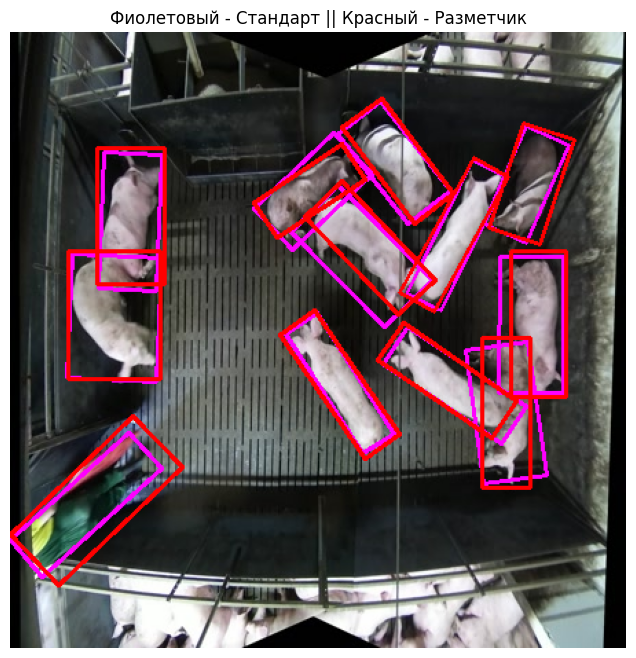


Image: 2_frame_0044.jpg
True Positives: 12
False Positives: 0
False Negatives: 0
Precision: 1.000
Recall: 1.000
F1 Score: 1.000
Mean IoU: 0.774
Cohen's Kappa (Grid-based): 0.853


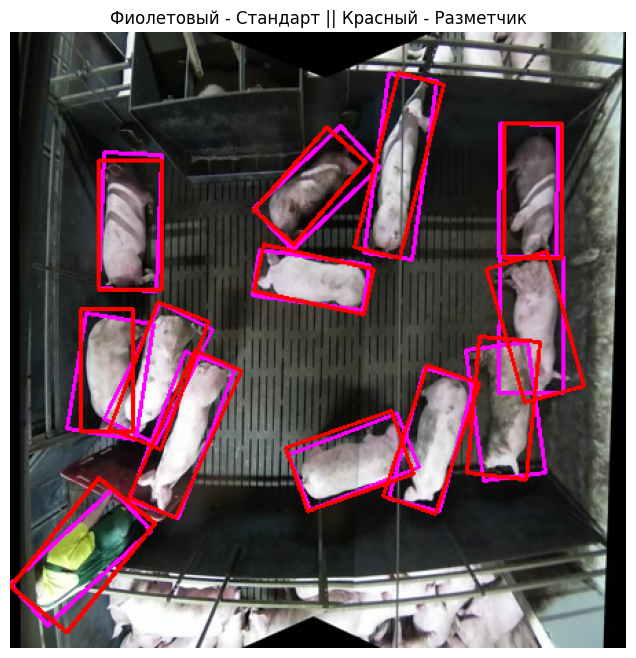


Image: 2_frame_0026.jpg
True Positives: 13
False Positives: 0
False Negatives: 0
Precision: 1.000
Recall: 1.000
F1 Score: 1.000
Mean IoU: 0.802
Cohen's Kappa (Grid-based): 0.869

=== ИТОГОВЫЕ МЕТРИКИ ===
Общее True Positives: 70
Общее False Positives: 3
Общее False Negatives: 3
Итоговая Precision: 0.959
Итоговая Recall: 0.959
Итоговый F1 Score: 0.959
Итоговое Mean IoU: 0.797
Итоговый Cohen's Kappa (Grid-based): 0.872


In [110]:
# Для разметчика worker_3
standard_dir = "golden_set/labels/" 
golden_set_images_dir = "golden_set/images" 

process_directory(standard_dir, annotator3_dir, golden_set_images_dir, iou_threshold)

### Третий разметчик worker_3_Ig_obb

Можно говорить об **очень высоком качестве разметки**:
 - **Precision**: `0.959` — практически все объекты, отмеченные разметчиком, соответствуют стандарту.
 - **Recall**: `0.959` — разметчик находит почти все объекты из стандарта.
 - **F1 Score**: `0.959` — гармоническое среднее между точностью и полнотой также находится на высоком уровне.

Средний коэффициент Каппа составляет `0.872`, что указывает на **очень высокую согласованность** с эталонной разметкой.
Среднее значение IoU составляет `0.797`, что указывает на **высокую точность локализации объектов**.

**Проблемные моменты**:
Пример проблемного случая — изображение `1_frame_0020.jpg`, где наблюдаются как ложноположительные, так и ложноотрицательные ошибки. Наблюдаются расхождения в ориентированности bbox.

В целом высокий уровень разметки, но можно также дать обратную связь с уточнениям по поводу ориентированности.